# Testing monomeric data

In [2]:
import os
import string
import numpy as np
import pandas as pd
from FlowCytometryTools import ThresholdGate, PolyGate
from matplotlib import pyplot as plt
from matplotlib import cm
from ckine.flow import importF
from ckine.FCimports import combineWells

In [3]:
path_ = os.path.abspath('')
pathname1 = str(path_ + "/ckine/data/flow/2019-11-08 monomer IL-2 Fc signaling/CD4 T cells - IL2-060 mono, IL2-060 dimeric")
pathname2 = str(path_ + "/ckine/data/flow/2019-11-08 monomer IL-2 Fc signaling/NK CD8 T cells - IL2-060 mono, IL2-060 dimeric")



In [4]:
def compMatrix(path_name, invert=True):
    """Creates compensation matrix given parameters date in mm-dd, plate number and panel A, B, or C."""
    path = path_ + path_name
    # imports csv file with comp values as a dataframe
    header_names = ['Channel1', 'Channel2', 'Comp']
    df_comp = pd.read_csv(path, header=None, skiprows=1, names=header_names)
    # Add diangonal values of 100 to compensation values
    addedChannels = []
    for i in df_comp.index:
        channelName = df_comp.iloc[i]['Channel1']
        if channelName not in addedChannels:  # Ensures a diagonal value is only added once for each channel
            addedChannels.append(channelName)
            df2 = pd.DataFrame([[channelName, channelName, 100]], columns=['Channel1', 'Channel2', 'Comp'])  # Creates new row for dataframe
            df_comp = df_comp.append(df2, ignore_index=True)  # Adds row
    # Create square matrix from compensation values
    df_matrix = pd.DataFrame(index=addedChannels, columns=addedChannels)  # df_matrix is now a square and has exactly one row and one column for each channel
    for i in df_matrix.index:
        for c in df_matrix.columns:
            df_matrix.at[i, c] = df_comp.loc[(df_comp['Channel1'] == c) & (df_comp['Channel2'] == i), 'Comp'].iloc[0]  # Fills in square matrix by finding corresponding comp value from csv
    # df_matrix now has all values in square matrix form
    df_matrix = df_matrix.div(100)
    if invert:  # true by default, inverts matrix before returning it
        a = np.matrix(df_matrix.values, dtype=float)  # Convert to np to allow for linalg usage
        df_matrix = pd.DataFrame(np.linalg.inv(a), df_matrix.columns, df_matrix.index)  # Calculate inverse and put pack as dataframe
    return df_matrix


def applyMatrix(sample, matrix):
    """Multiples two matrices together in the order sample dot matrix"""
    holder = pd.DataFrame()  # Will hold columns not being compensated
    for c in sample.data.columns:
        if c not in matrix:  # If sample channel column is not found in matrix
            holder = holder.join(sample.data[[c]], how='right')  # Store for after calculation
            sample.data = sample.data.drop([c], axis=1)  # Removed column to allow for matrix multiplication

    cols = sample.data.columns
    matrix = matrix[cols]
    matrix = matrix.reindex(cols)
    sample.data = sample.data.dot(matrix)  # Use matrix multiplication to compensate the relevant data
    sample.data = sample.data.join(holder)  # Restore uncompensated channels to sample
    return sample

In [5]:
Tsample1A, _ = importF(pathname1, "A")
Cd8_NKsample1A, _ = importF(pathname2, "A")

TsampleA = combineWells(Tsample1A)
Cd8_NKsampleA = combineWells(Cd8_NKsample1A)

T_matrixA = compMatrix("/ckine/data/compensation/CD4+ comp matrix.csv") #Create matrix 1
Cd8_NKmatrixA = compMatrix("/ckine/data/compensation/CD8-CD56 comp matrix.csv") #Create matrix 2
print(T_matrixA)
print(Cd8_NKmatrixA)

TsampleA = applyMatrix(TsampleA, T_matrixA) #Apply matrix 1
Cd8_NKsampleA = applyMatrix(Cd8_NKsampleA, Cd8_NKmatrixA) #Apply matrix 2 

TsampleA = TsampleA.transform("tlog", channels=['VL1-H', 'VL4-H', 'BL1-H','BL3-H']) #Tlog transformations
Cd8_NKsampleA = Cd8_NKsampleA.transform("tlog", channels=['RL1-H', 'VL4-H', 'BL1-H', 'BL2-H']) #Tlog transformations



          VL4-H     BL1-H     BL3-H     RL1-H     VL1-H
VL4-H  1.008869  0.000167 -0.064736 -0.005219 -0.011954
BL1-H  0.007622  1.000145 -0.056600  0.000092 -0.000082
BL3-H -0.135851 -0.002579  1.008869 -0.001644  0.001468
RL1-H  0.000505  0.000010 -0.003546  1.000006 -0.002176
VL1-H -0.012945 -0.000516  0.000859  0.000067  1.000153
              BL1-H     BL2-H     RL1-H     VL4-H
BL1-H  1.009945e+00 -0.159789  0.004325  0.027020
BL2-H -6.289218e-02  1.010511 -0.065741 -0.177534
RL1-H -1.761855e-07  0.000003  1.000006 -0.000880
VL4-H  2.004386e-04 -0.003221 -0.006801  1.000572


## C) T helper and T regulatory cells

Percent gated as CD4+:  23.77807176465988 %


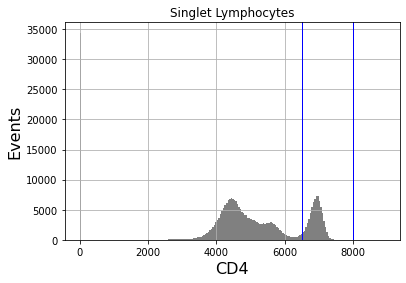

In [6]:
cd4_gate = ThresholdGate(6500.0, ['VL4-H'], region='above') & ThresholdGate(8000.0, ['VL4-H'], region='below')
_ = TsampleA.plot(['VL4-H'], gates=cd4_gate) #CD4
plt.title("Singlet Lymphocytes")
plt.xlabel("CD4")
plt.ylabel("Events")
plt.grid()
print("Percent gated as CD4+: ", TsampleA.gate(cd4_gate).counts/TsampleA.counts*100., "%")

Percent gated as T reg:  6.017294067668864 %
Percent gated as T helper:  85.7988571115344 %


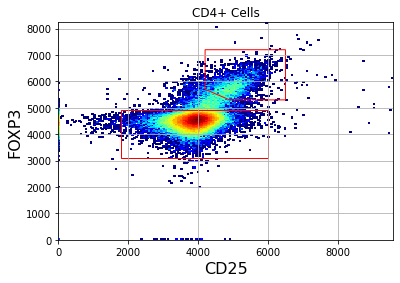

In [7]:
sampleCD4 = TsampleA.gate(cd4_gate)
Treg_gate = PolyGate([(4.2e3,7.2e3), (6.5e03, 7.2e03), (6.5e03, 5.3e03), (4.9e03, 5.3e03), (4.2e03, 5.7e03)], ('VL1-H', 'BL1-H'), region='in', name='treg')
Thelp_gate = PolyGate([(1.8e03, 3.1e03), (1.8e03, 4.9e03), (6.0e03, 4.9e03), (6.0e03, 3.1e03)], ('VL1-H', 'BL1-H'), region='in', name='thelper')
_ = sampleCD4.plot(['VL1-H', 'BL1-H'], gates=[Treg_gate,Thelp_gate], gate_colors=['red','red'], cmap=cm.jet) #CD4
plt.title("CD4+ Cells")
plt.xlabel("CD25")
plt.ylabel("FOXP3")
plt.grid()
print("Percent gated as T reg: ", sampleCD4.gate(Treg_gate).counts/sampleCD4.counts*100., "% (Manuscript: 5.6% ")
print("Percent gated as T helper: ", sampleCD4.gate(Thelp_gate).counts/sampleCD4.counts*100., "% (Manuscript: 91%")


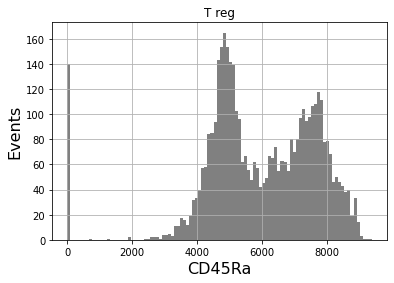

In [8]:
tregSample= sampleCD4.gate(Treg_gate)
_ = tregSample.plot(['BL3-H'], gates=None, bins=100) #CD4
plt.title("T reg")
plt.xlabel("CD45Ra")
plt.ylabel("Events")
plt.grid()


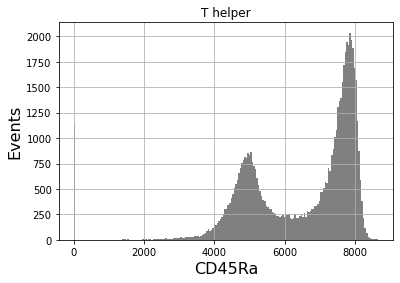

In [9]:
ThelperSample= sampleCD4.gate(Thelp_gate)
_ = ThelperSample.plot(['BL3-H'], gates=None) #CD4
plt.title("T helper")
plt.xlabel("CD45Ra")
plt.ylabel("Events")
plt.grid()

Percent gated as CD3+CD8+:  21.036797418706964 %


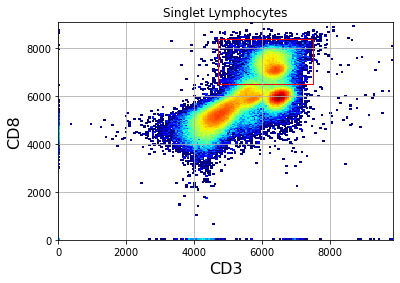

In [10]:
#CD8+ Cells
CD3CD8gate = PolyGate([(7.5e3,8.4e3), (4.7e3, 8.4e3), (4.7e03, 6.5e03), (7.5e03, 6.5e03)], ('VL4-H', 'RL1-H'), region='in', name='treg')
_ = Cd8_NKsampleA.plot(['VL4-H', 'RL1-H'], gates=CD3CD8gate, gate_colors='red', cmap=cm.jet) #CD3, CD8
plt.title("Singlet Lymphocytes")
plt.xlabel("CD3")
plt.ylabel("CD8")
plt.grid()
print("Percent gated as CD3+CD8+: ", Cd8_NKsampleA.gate(CD3CD8gate).counts/Cd8_NKsampleA.counts*100., "% (Manuscript: 24%")

Percent gated as NK:  3.7871585610279075 %
Percent gated as CD56bright NK:  0.21606805526403516 %


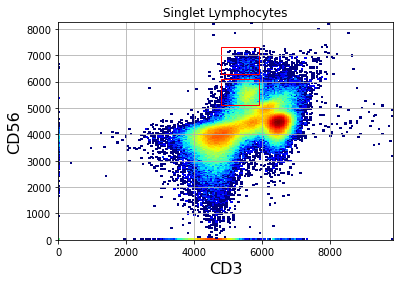

In [11]:
#NK Cells 
NKgate = PolyGate([(4.8e3,5.1e3), (5.9e3, 5.1e3), (5.9e03, 6.1e03), (4.8e03, 6.1e03)], ('VL4-H', 'BL1-H'), region='in', name='treg')
CD56brightgate = PolyGate([(4.8e3,6.3e3), (5.9e3, 6.3e3), (5.9e03, 7.3e03), (4.8e03, 7.3e03)], ('VL4-H', 'BL1-H'), region='in', name='treg')
_ = Cd8_NKsampleA.plot(['VL4-H', 'BL1-H'], gates=[NKgate, CD56brightgate], gate_colors=['red', 'red'], cmap=cm.jet) #CD3, CD56
plt.title("Singlet Lymphocytes")
plt.xlabel("CD3")
plt.ylabel("CD56")
plt.grid()
print("Percent gated as NK: ", Cd8_NKsampleA.gate(NKgate).counts/Cd8_NKsampleA.counts*100., "% (Manuscript: 3.6%")
print("Percent gated as CD56bright NK: ", Cd8_NKsampleA.gate(CD56brightgate).counts/Cd8_NKsampleA.counts*100., "% (Manuscript: 0.3%")